In [1]:
from typing import Union
import scanpy as sc
import anndata
import logging
import os
import numpy as np
import pandas as pd
import json
import sys
logging.basicConfig(level=logging.INFO)

from sklearn.neighbors import KNeighborsClassifier
from sklearn import svm

import matplotlib.pyplot as plt
import seaborn as sns

from dredFISH.Analysis import basicu
from dredFISH.Analysis import regu
from dredFISH.Analysis import celltypeu
from dredFISH.Analysis import evalu
from dredFISH.Analysis import TissueGraph as tgh

import importlib
importlib.reload(tgh)
importlib.reload(celltypeu)
importlib.reload(evalu)
importlib.reload(basicu)
sc.set_figure_params(figsize=(7, 7))

In [2]:
logging.info('hi')

INFO:root:hi


# file paths and load data

In [3]:
prj_dir = '/bigstore/GeneralStorage/fangming/projects/dredfish/'
dat_dir = prj_dir + 'data/'
res_dir = prj_dir + 'data_dump/'
fig_dir = prj_dir + 'figures/'

# dredFISH data
dataset = 'DPNMF_PolyA_2021Nov19' # dataset tag
base_path = '/bigstore/Images2021/gaby/dredFISH/DPNMF_PolyA_2021Nov19/'
fish_path = f'{base_path}fishdata_2022Mar23/' # Zach's new version
# anndata_path = f'{base_path}results/raw_fishdata_Mar30.h5ad'
anndata_path = '/bigstore/GeneralStorage/fangming/projects/dredfish/data_dump/DPNMF_PolyA_2021Nov19_v2_results_anndata.h5ad'
# anndata_path = ''

# allen data
scrna_path = '/bigstore/GeneralStorage/fangming/projects/dredfish/data/rna/scrna_ss_ctxhippo_a_exon_DPNMF_matrix.h5ad'
# scrna_path = '/bigstore/GeneralStorage/fangming/projects/dredfish/data/rna/scrna_10x_ctxhippo_a_DPNMF_matrix.h5ad'

# allen tree
allen_tree_path='/bigstore/GeneralStorage/fangming/reference/allen_ccf/structures.json'

In [4]:
%%time
# load dredFISH
TMG = tgh.TissueMultiGraph(name=dataset)
# load raw counts data
if os.path.isfile(anndata_path):
    print('from AnnData')
    TMG.load_from_anndata(anndata_path)
else:
    print('from FishData')
    TMG.load_from_fishdata(fish_path, dataset, output_path=anndata_path)
# normalize (optional for spatial registration)
TMG.normalize_data(norm_cell=True, norm_bit=False)

### for now
data = TMG.data
# print(data)
    
# allen scrna matrix
ref_data = anndata.read_h5ad(scrna_path)
# print(ref_data)

# allen tree
allen_tree, allen_maps = regu.load_allen_tree(allen_tree_path)

from AnnData


INFO:root:113758 cells, minimum counts = 1248.0


CPU times: user 474 ms, sys: 147 ms, total: 621 ms
Wall time: 619 ms


In [5]:
# # select specific regions
# selected_regions = ['Isocortex', 'HPF']
# selected_all_sids = regu.expand_regions(allen_tree, selected_regions, 'acronym')

# # selected cells
# cond_cells = data.obs['region_id'].isin(selected_all_sids)
# data = data[cond_cells]
# data

In [6]:
# prepare
ref_data.obs = ref_data.obs.rename(columns={
    'class_label': 'Level_1_class_label', 
    'neighborhood_label': 'Level_2_neighborhood_label', 
    'subclass_label': 'Level_3_subclass_label', 
    # 'supertype_label', 
    'cluster_label': 'Level_5_cluster_label', 
})

celltype_levels = np.sort(ref_data.obs.filter(regex=r'^Level_[0-9]', axis=1).columns.values)
print(celltype_levels)

levels = celltype_levels[:3]      
X_data = np.array(data.layers['norm_cell'])
X_refdata = np.array(ref_data.X)
Y_refdata = ref_data.obs[levels].values

print(levels, X_data.shape, X_refdata.shape, Y_refdata.shape)

['Level_1_class_label' 'Level_2_neighborhood_label'
 'Level_3_subclass_label' 'Level_5_cluster_label']
['Level_1_class_label' 'Level_2_neighborhood_label'
 'Level_3_subclass_label'] (113758, 24) (73347, 24) (73347, 3)


## run -- baseline 
- takes ~8s
- bias towards small cell types

- `KNN` is better at broad cell types (glia vs neurons)
- `SVM (rbf kernel)` is better at PT and PT subtypes

In [7]:
%%time
# run # baseline
importlib.reload(celltypeu)
output = f"{res_dir}celltypes_allcells_baseline_version1_April27.npy"

# choosing models: they overall performed similar, but each has some unique strengths
model = KNeighborsClassifier(n_neighbors=15, metric='correlation') # metric 'cosine' is also good
# model = svm.SVC(kernel='rbf') # # this is also good 


norm = 'per_bit_equalscale'
ranknorm = False
n_cells = 100

y_data = celltypeu.iterative_classify(
                 X_refdata,
                 Y_refdata,
                 X_data,
                 levels,
                 # run_func='run', # baseline
                 run_func='run', # baseline
                 run_kwargs_perlevel=[dict(norm=norm, ranknorm=ranknorm, n_cells=n_cells)], 
                 model=model,
                 verbose=True,
                 ignore_internal_failure=False,
)
print(output)
np.save(output, y_data)

INFO:root:iteration 1/3
INFO:root:Current round: level_0
INFO:root:iteration 2/3
INFO:root:Current round: level_1_cluster_GABAergic
INFO:root:Current round: level_1_cluster_Glutamatergic
INFO:root:Current round: level_1_cluster_Non-Neuronal
INFO:root:iteration 3/3
INFO:root:Current round: level_2_cluster_CGE
INFO:root:Current round: level_2_cluster_MGE
INFO:root:Current round: level_2_cluster_Other
INFO:root:Current round: level_2_cluster_DG/SUB/CA
INFO:root:Current round: level_2_cluster_L2/3 IT
INFO:root:Current round: level_2_cluster_L4/5/6 IT Car3
INFO:root:Current round: level_2_cluster_NP/CT/L6b
INFO:root:Current round: level_2_cluster_Other
INFO:root:Current round: level_2_cluster_PT
INFO:root:Current round: level_2_cluster_Other


/bigstore/GeneralStorage/fangming/projects/dredfish/data_dump/celltypes_allcells_baseline_version1_April27.npy
CPU times: user 16.3 s, sys: 481 ms, total: 16.8 s
Wall time: 17.2 s


## run -- iterative prior
- takes ~5min
- bias towards large cell types
- uncomment to run

In [8]:
# %%time
# # recipe
# importlib.reload(celltypeu)
# output = f"{res_dir}celltypes_iterative_prior_version1_April19.npy"

# norm = 'per_bit_equalscale'
# ranknorm = False
# model = KNeighborsClassifier(n_neighbors=15, metric='correlation')

# run_kwargs_perlevel = [
#     dict(overall_sample_fraction=0.1, # as large as possible, but should allow wiggle room to adjust sampled composition
#         min_total_cells=100,
#         min_cells=20, # should be > n_neighbors in kNN algorithm
#         p0 = 0.5,
#         norm=norm,
#         ranknorm=ranknorm,
#         subrun_func='run',
#         ),
    
#     dict(overall_sample_fraction=0.4, # as large as possible, but should allow wiggle room to adjust sampled composition
#         min_total_cells=100,
#         min_cells=20, # should be > n_neighbors in kNN algorithm
#         p0 = 0.5,
#         norm=norm,
#         ranknorm=ranknorm,
#         subrun_func='run',
#         ),
    
#     dict(overall_sample_fraction=0.8, # as large as possible, but should allow wiggle room to adjust sampled composition
#         min_total_cells=100,
#         min_cells=20, # should be > n_neighbors in kNN algorithm
#         p0 = 0.5,
#         norm=norm,
#         ranknorm=ranknorm,
#         subrun_func='run',
#         ),
# ]

# levels = celltype_levels[:3]

# y_data = celltypeu.iterative_classify(
#                  X_refdata,
#                  Y_refdata,
#                  X_data,
#                  levels,
#                  run_func='run_iterative_prior', # 
#                  # run_func='run', # 
#                  run_kwargs_perlevel=run_kwargs_perlevel,
#                  model=model,
#                  ignore_internal_failure=False,
#                  verbose=True,
# )

# print(output)
# np.save(output, y_data)

# Evaluate and save 

In [9]:
# # for evaluations
# input_embed1 = f'{res_dir}Joint_UMAP_isocortex_hpf_April1.csv'
# print(input_embed1)
# input_embed2 = f'{res_dir}Joint_UMAP_isocortex_hpf_subsamp100_level1_April1.csv'
# print(input_embed2)

# analysis metadata
meta_path = '/bigstore/GeneralStorage/fangming/projects/dredfish/data_dump/analysis_meta_Mar31.json'

In [10]:
# analysis
with open(meta_path, 'r') as fh:
    meta = json.load(fh)

In [11]:
# f = "/bigstore/GeneralStorage/fangming/projects/dredfish/data_dump/celltypes_baseline_version1_April19.npy"
# f = "/bigstore/GeneralStorage/fangming/projects/dredfish/data_dump/celltypes_iterative_prior_version1_April19.npy"
f = output
print(f)

y_data = np.load(f, allow_pickle=True)
res = data.obs.copy() #pd.DataFrame(index=data.obs.index)
for i, level in enumerate(levels):
    res[level] = y_data[:,i]
res

/bigstore/GeneralStorage/fangming/projects/dredfish/data_dump/celltypes_allcells_baseline_version1_April27.npy


,label,pixel_x,pixel_y,nuclei_size,nuclei_signal,cytoplasm_size,cytoplasm_signal,total_size,total_signal,posname,...,stage_x,stage_y,coord_x,coord_y,region_id,region_color,region_acronym,Level_1_class_label,Level_2_neighborhood_label,Level_3_subclass_label
DPNMF_PolyA_2021Nov19_Pos98_cell_1.0,1.0,11.001562,86.770309,640.0,25904.0,223.0,25840.0,851.0,25984.0,Pos98,...,-2413.586509,3496.712879,3066.632792,582.574703,574,#98D6F9,CP,Non-Neuronal,Other,Endo
DPNMF_PolyA_2021Nov19_Pos98_cell_2.0,2.0,7.031977,249.014542,344.0,10288.0,86.0,14240.0,428.0,10944.0,Pos98,...,-2412.292424,3443.821259,3013.860099,578.800986,1202,#CCCCCC,int,Non-Neuronal,Other,SMC-Peri
DPNMF_PolyA_2021Nov19_Pos98_cell_3.0,3.0,11.855099,797.958862,559.0,40080.0,185.0,34112.0,737.0,38256.0,Pos98,...,-2413.864762,3264.865411,2835.027489,571.977073,1218,#CCCCCC,ar,Glutamatergic,Other,CR
DPNMF_PolyA_2021Nov19_Pos98_cell_4.0,4.0,14.233974,951.783630,624.0,40800.0,305.0,38144.0,800.0,42784.0,Pos98,...,-2414.640276,3214.718536,2784.899438,570.399427,1218,#CCCCCC,ar,Glutamatergic,DG/SUB/CA,DG
DPNMF_PolyA_2021Nov19_Pos98_cell_5.0,5.0,4.344828,986.775879,174.0,49776.0,174.0,44896.0,336.0,48496.0,Pos98,...,-2411.416414,3203.311063,2773.655749,566.644009,1218,#CCCCCC,ar,Glutamatergic,DG/SUB/CA,DG
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
DPNMF_PolyA_2021Nov19_Pos102_cell_1357.0,1357.0,2041.041992,695.351379,333.0,53968.0,306.0,42000.0,639.0,48800.0,Pos102,...,-414.379689,3298.315450,2962.233204,-1423.737878,1200,#CCCCCC,ccs,Glutamatergic,NP/CT/L6b,L6 CT CTX
DPNMF_PolyA_2021Nov19_Pos102_cell_1358.0,1358.0,2037.588257,1224.082397,85.0,39376.0,1197.0,43952.0,1324.0,43760.0,Pos102,...,-413.253772,3125.949138,2790.109448,-1432.947971,463,#7ED04B,CA2,Glutamatergic,NP/CT/L6b,L6b/CT ENT
DPNMF_PolyA_2021Nov19_Pos102_cell_1359.0,1359.0,2041.656616,649.783142,166.0,26304.0,398.0,32912.0,564.0,31136.0,Pos102,...,-414.580057,3313.170696,2977.062698,-1422.840896,1200,#CCCCCC,ccs,Glutamatergic,NP/CT/L6b,L6 CT CTX
DPNMF_PolyA_2021Nov19_Pos102_cell_1360.0,1360.0,2045.224976,582.000000,80.0,10432.0,145.0,20800.0,201.0,18336.0,Pos102,...,-415.743342,3335.268000,2999.081110,-1420.642344,1200,#CCCCCC,ccs,Non-Neuronal,Other,Oligo


In [12]:
# f = "/bigstore/GeneralStorage/fangming/projects/dredfish/data_dump/celltypes_iterative_prior_version1_April19.npy"
f = "/bigstore/GeneralStorage/fangming/projects/dredfish/data_dump/celltypes_iterative_prior_version1_April19.csv"
res2 = pd.read_csv(f, index_col=0)
res2 = res.join(res2, lsuffix='_all', rsuffix='')
res2
# # f = output
# print(f)

# y_data2 = np.load(f, allow_pickle=True)
# res2 = data.obs.copy() #pd.DataFrame(index=data.obs.index)
# for i, level in enumerate(levels):
#     res2[level] = y_data2[:,i]
# res2

,label,pixel_x,pixel_y,nuclei_size,nuclei_signal,cytoplasm_size,cytoplasm_signal,total_size,total_signal,posname,...,coord_y,region_id,region_color,region_acronym,Level_1_class_label_all,Level_2_neighborhood_label_all,Level_3_subclass_label_all,Level_1_class_label,Level_2_neighborhood_label,Level_3_subclass_label
DPNMF_PolyA_2021Nov19_Pos98_cell_1.0,1.0,11.001562,86.770309,640.0,25904.0,223.0,25840.0,851.0,25984.0,Pos98,...,582.574703,574,#98D6F9,CP,Non-Neuronal,Other,Endo,NaN,NaN,NaN
DPNMF_PolyA_2021Nov19_Pos98_cell_2.0,2.0,7.031977,249.014542,344.0,10288.0,86.0,14240.0,428.0,10944.0,Pos98,...,578.800986,1202,#CCCCCC,int,Non-Neuronal,Other,SMC-Peri,NaN,NaN,NaN
DPNMF_PolyA_2021Nov19_Pos98_cell_3.0,3.0,11.855099,797.958862,559.0,40080.0,185.0,34112.0,737.0,38256.0,Pos98,...,571.977073,1218,#CCCCCC,ar,Glutamatergic,Other,CR,NaN,NaN,NaN
DPNMF_PolyA_2021Nov19_Pos98_cell_4.0,4.0,14.233974,951.783630,624.0,40800.0,305.0,38144.0,800.0,42784.0,Pos98,...,570.399427,1218,#CCCCCC,ar,Glutamatergic,DG/SUB/CA,DG,NaN,NaN,NaN
DPNMF_PolyA_2021Nov19_Pos98_cell_5.0,5.0,4.344828,986.775879,174.0,49776.0,174.0,44896.0,336.0,48496.0,Pos98,...,566.644009,1218,#CCCCCC,ar,Glutamatergic,DG/SUB/CA,DG,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
DPNMF_PolyA_2021Nov19_Pos102_cell_1357.0,1357.0,2041.041992,695.351379,333.0,53968.0,306.0,42000.0,639.0,48800.0,Pos102,...,-1423.737878,1200,#CCCCCC,ccs,Glutamatergic,NP/CT/L6b,L6 CT CTX,NaN,NaN,NaN
DPNMF_PolyA_2021Nov19_Pos102_cell_1358.0,1358.0,2037.588257,1224.082397,85.0,39376.0,1197.0,43952.0,1324.0,43760.0,Pos102,...,-1432.947971,463,#7ED04B,CA2,Glutamatergic,NP/CT/L6b,L6b/CT ENT,Glutamatergic,NP/CT/L6b,L6 CT CTX
DPNMF_PolyA_2021Nov19_Pos102_cell_1359.0,1359.0,2041.656616,649.783142,166.0,26304.0,398.0,32912.0,564.0,31136.0,Pos102,...,-1422.840896,1200,#CCCCCC,ccs,Glutamatergic,NP/CT/L6b,L6 CT CTX,NaN,NaN,NaN
DPNMF_PolyA_2021Nov19_Pos102_cell_1360.0,1360.0,2045.224976,582.000000,80.0,10432.0,145.0,20800.0,201.0,18336.0,Pos102,...,-1420.642344,1200,#CCCCCC,ccs,Non-Neuronal,Other,Oligo,NaN,NaN,NaN


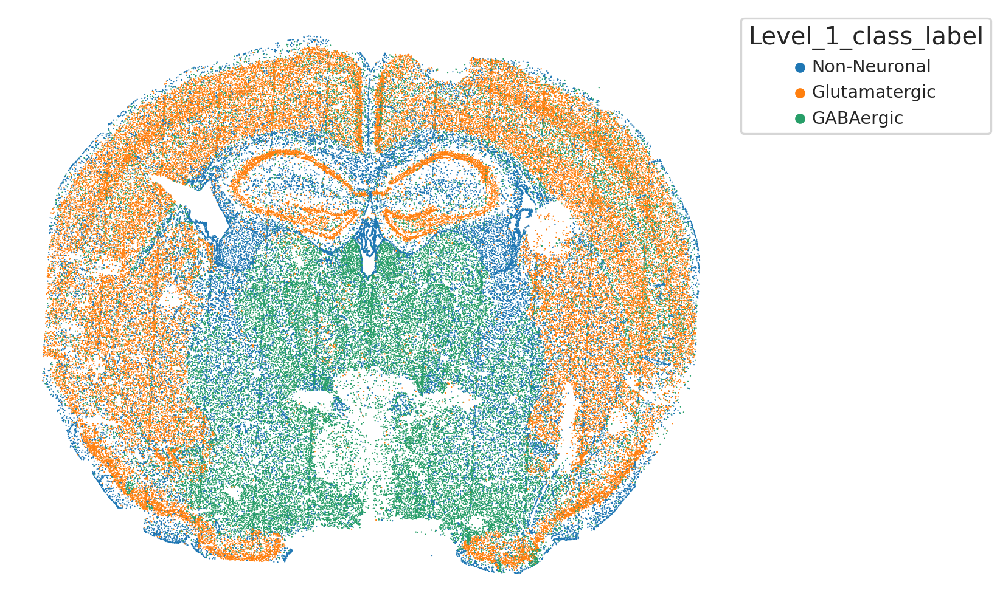

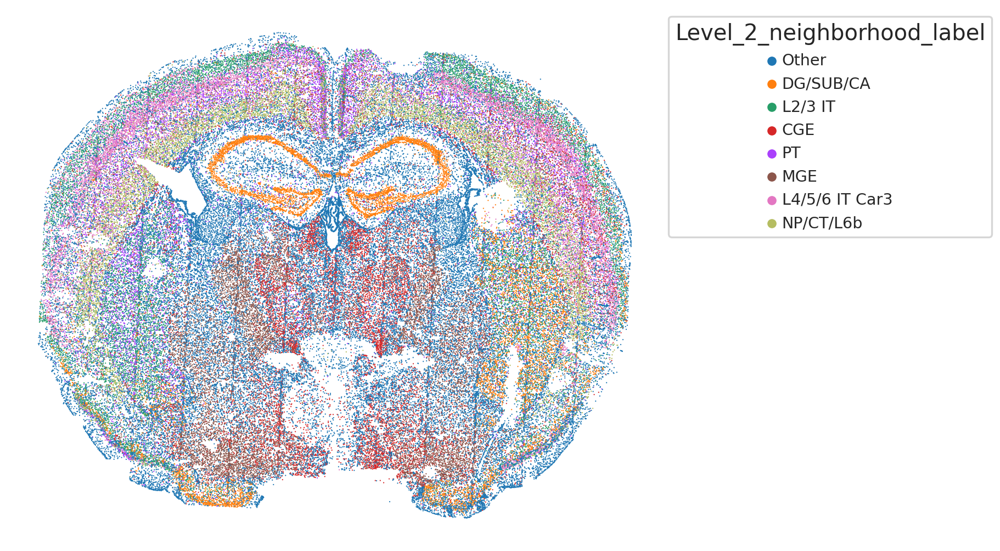

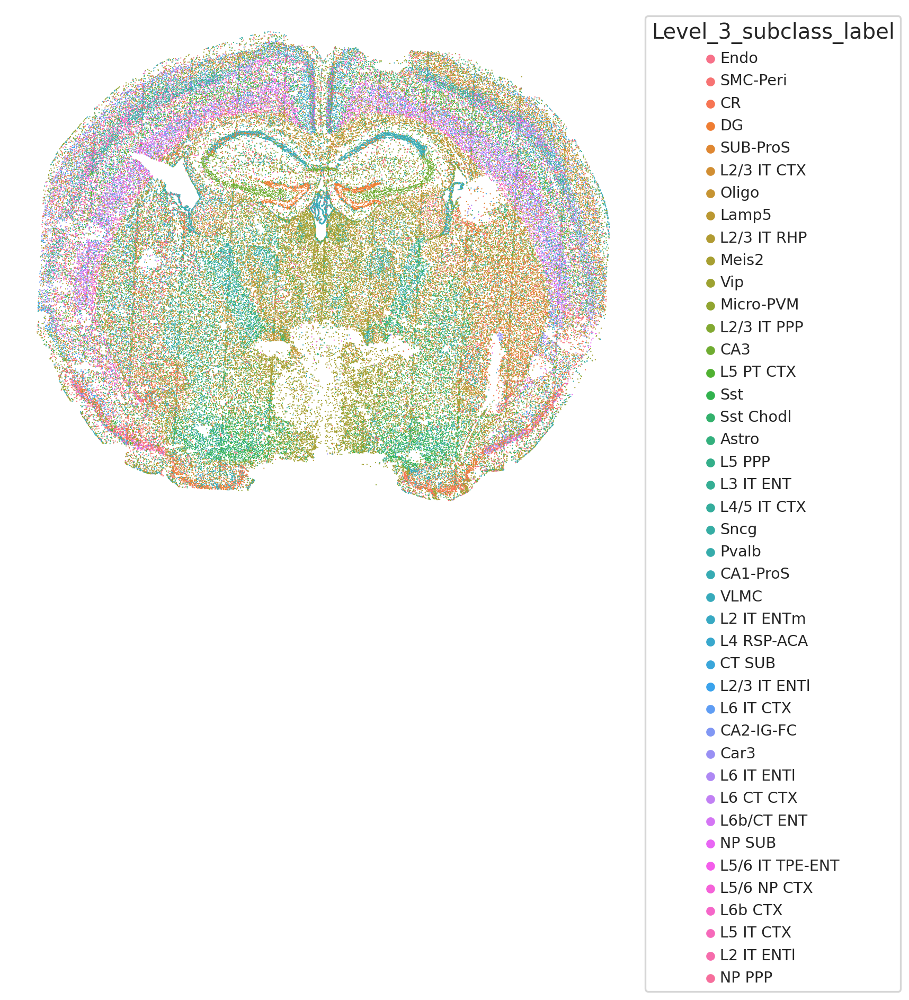

In [13]:
for level in levels:
    fig, ax = plt.subplots(figsize=(10,8))
    sns.scatterplot(data=res, x='coord_x', y='coord_y', hue=level,
                    # hue_order=np.sort(np.unique(res[level])),
                    s=1,
                    edgecolor='none',
                    rasterized=True,
                   )
    ax.axis('off')
    ax.legend(bbox_to_anchor=(1,1), 
              loc='upper left', 
              # ncol=1+int(len(np.unique(res[level]))/20), 
              title=level,
             )
    ax.invert_yaxis()
    ax.set_aspect('equal')
    plt.show()

In [14]:
# # results
dftypes = res.copy() #pd.read_csv(input_celltypes, index_col=0)
dftypes = dftypes.filter(regex=r'^Level_[0-9]', axis=1)
levels = dftypes.columns.values

# update data
# data.obs = data.obs.join(dftypes)
for level in levels:
    if level in data.obs.columns.values:
        data.obs = data.obs.drop(level, axis=1)
data.obs = data.obs.join(dftypes)

# # update the joint one
# dfembed1 = pd.read_csv(input_embed1, index_col=0)
# dfembed2 = pd.read_csv(input_embed2, index_col=0)
# dfembed1 = dfembed1.join(pd.concat([data.obs, ref_data.obs]))
# dfembed2 = dfembed2.join(pd.concat([data.obs, ref_data.obs]))

# print(dftypes.shape, dfembed1.shape, dfembed2.shape, data.obs.shape)

# Organize information

In [15]:
# importlib.reload(evalu)
resobj = evalu.Level3Res(meta, levels, 
                ref_data, data, 
                refdata_name='scRNA-seq', data_name='dredFISH',
                # embed=True, df_embed=dfembed1,
                embed=False,
               )

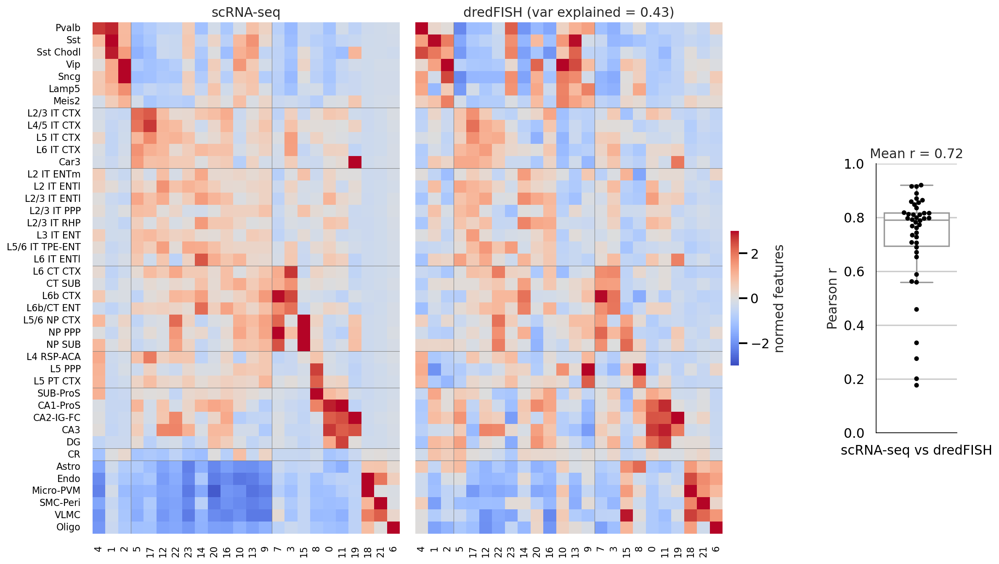

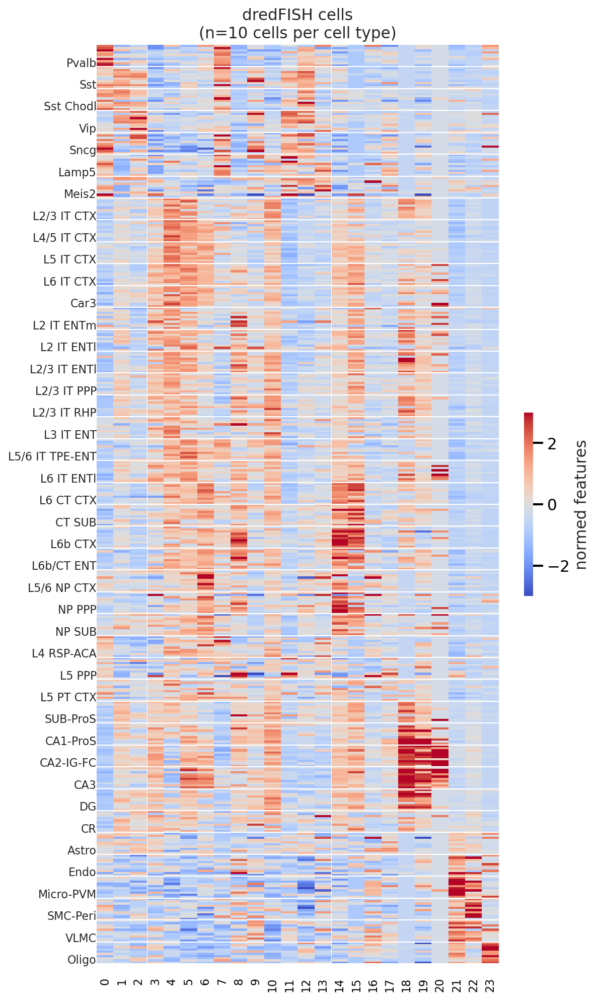

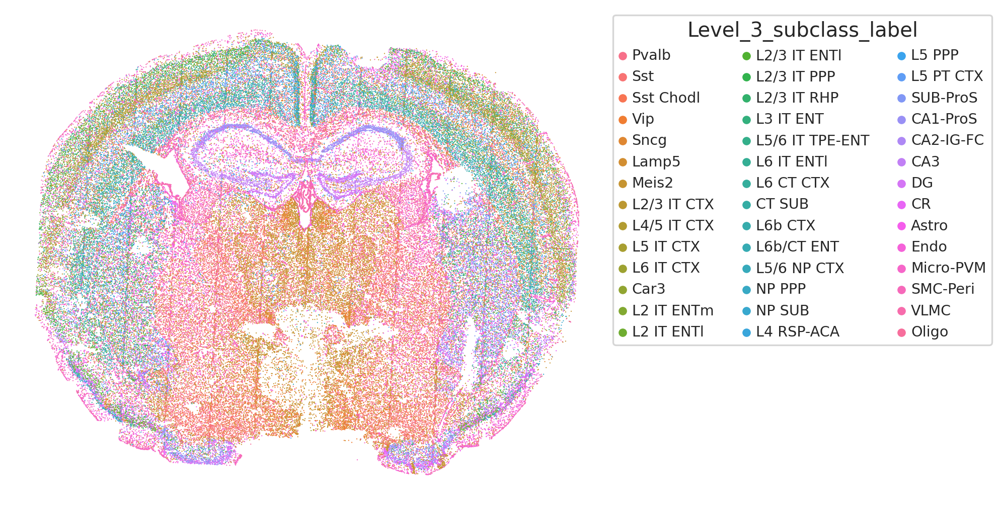

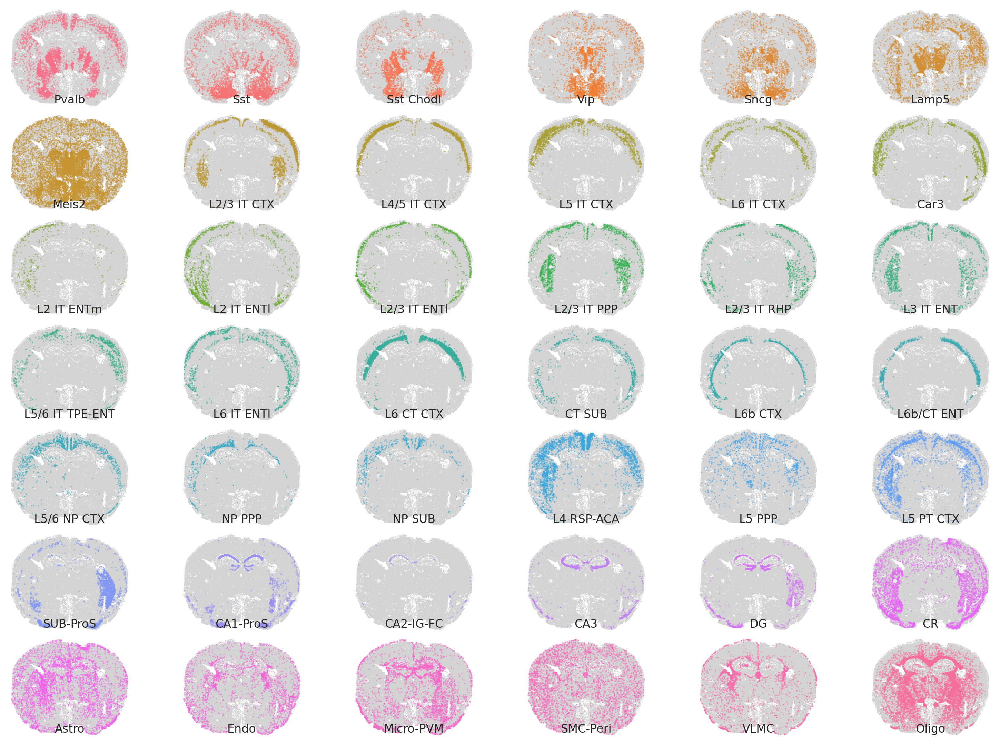

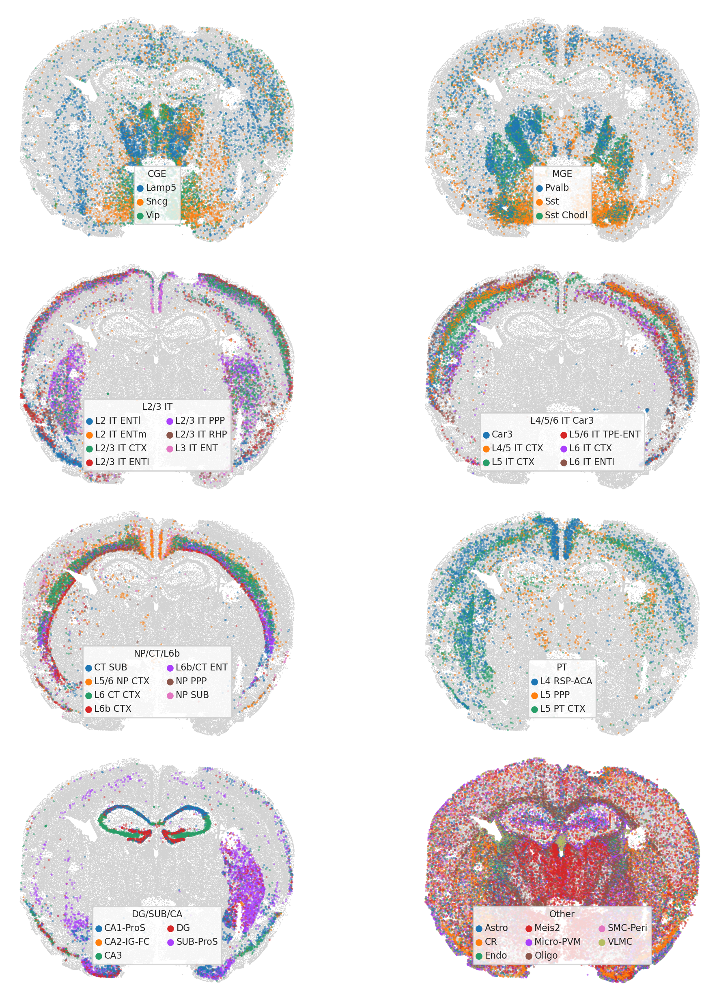

In [16]:

# embed eval
# resobj.plot_embeds(hues=['dataset']+levels[:2].tolist())

# gene eval
resobj.plot_genes()

# spatial eval
resobj.plot_spatial()


# Customized figures
- spatial hierarchy

In [17]:
import collections
from matplotlib.patches import Rectangle
from mpl_toolkits.axes_grid1.inset_locator import inset_axes
from dredFISH.Analysis import powerplots
importlib.reload(powerplots)
importlib.reload(basicu)

# reset logging level; supress matplotlib info
basicu.reset_logging(level=logging.WARNING)
logging.info('hi')

In [18]:
# colors = sns.color_palette('Set2', n_colors=11)
# https://mokole.com/palette.html
# colors = [
#     '#4682b4',
#     '#228b22',
#     '#ffd700',
    
#     '#4b0082',
#     '#ff0000',
#     '#00ff00',
#     '#00ffff',
#     '#000080',
    
#     '#0000ff',
#     '#ff69b4',
#     '#8b4513',
# ]           


# colors = [
#     '#69BD45',
#     '#6FCCDD',
#     '#ED2024',
# ]           

colors = [
    '#4682b4',
    '#228b22',
    '#ffd700',
    
    '#008080',
    '#ffa500',
    '#00ff00',
    '#0000ff',
    '#ff1493',
    
    '#69BD45',
    '#6FCCDD',
    '#ED2024',
]           

saved the figure to: /bigstore/GeneralStorage/fangming/projects/dredfish/figures/spatial_level1_celltypes_allcells_2022-05-11.pdf


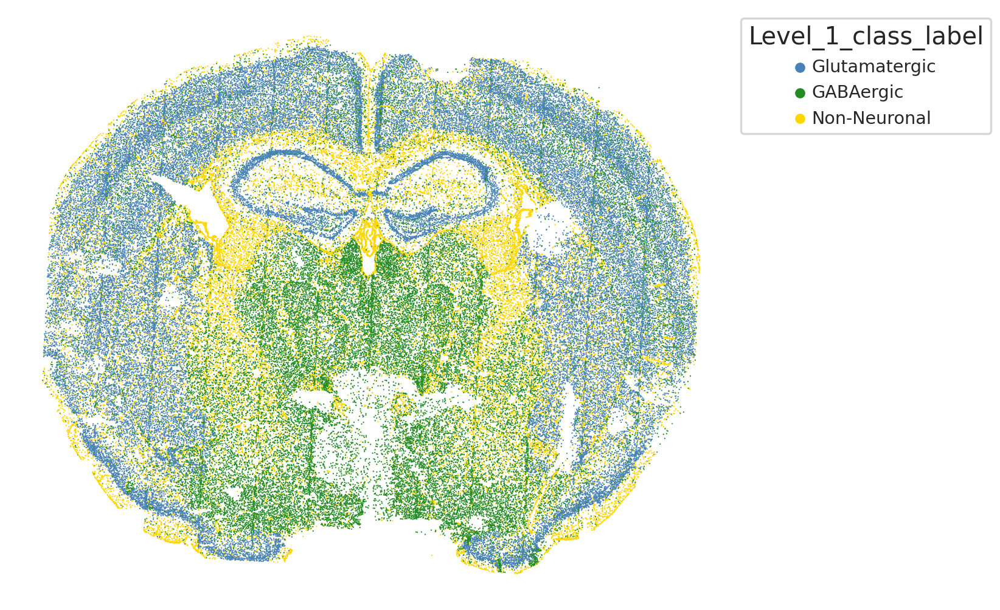

In [19]:
palette_l1 = collections.OrderedDict({
    'Glutamatergic': colors[0], 
    'GABAergic': colors[1], 
    'Non-Neuronal': colors[2], 
})

level = levels[0]
fig, ax = plt.subplots(figsize=(10,8))
sns.scatterplot(data=res, x='coord_x', y='coord_y', hue=level,
                # hue_order=np.sort(np.unique(res[level])),
                hue_order=list(palette_l1.keys()),
                palette=palette_l1,
                s=1,
                edgecolor='none',
                rasterized=True,
               )
ax.axis('off')
ax.legend(bbox_to_anchor=(1,1), 
          loc='upper left', 
          # ncol=1+int(len(np.unique(res[level]))/20), 
          title=level,
         )
ax.invert_yaxis()
ax.set_aspect('equal')

powerplots.savefig_autodate(fig, os.path.join(fig_dir, 'spatial_level1_celltypes_allcells.pdf'))
plt.show()

In [20]:
len(res), len(res2)

(113758, 113758)

saved the figure to: /bigstore/GeneralStorage/fangming/projects/dredfish/figures/spatial_level2_hippo_allcells_2022-05-11.pdf


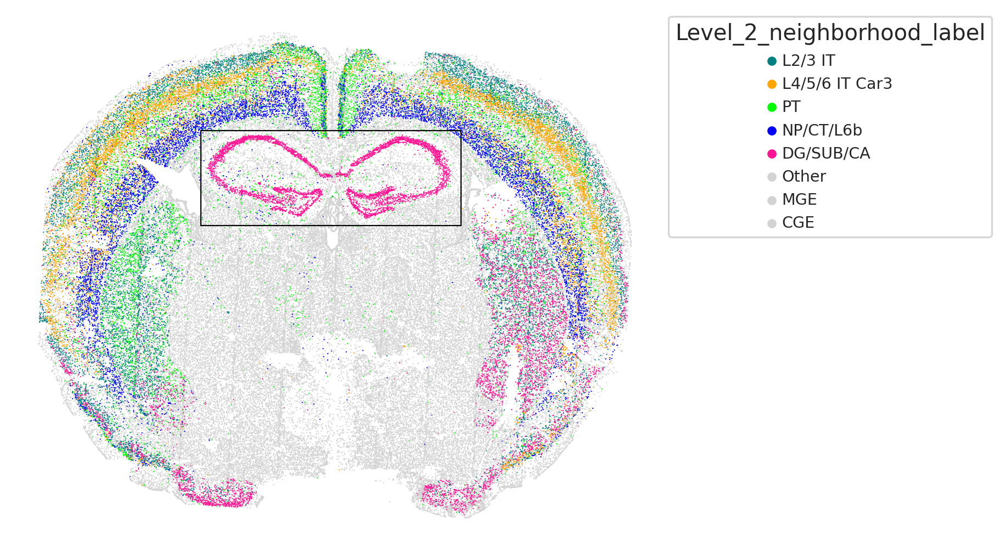

In [21]:
palette_l2 = collections.OrderedDict({
    'L2/3 IT': colors[3],
    'L4/5/6 IT Car3': colors[4],
    'PT': colors[5],
    'NP/CT/L6b': colors[6],
    'DG/SUB/CA': colors[7],
    'Other': 'lightgray',
    'MGE': 'lightgray',
    'CGE': 'lightgray',
})
hue_order = list(palette_l2.keys())

level = levels[1]
# # dfplot = res[res[levels[0]]=='Glutamatergic']
# dfplot = res2.copy() #[res[levels[0]]=='Glutamatergic']
# dfplot[level] = dfplot[level].fillna('Other')
dfplot = res

fig, ax = plt.subplots(figsize=(10,8))
sns.scatterplot(data=dfplot, x='coord_x', y='coord_y', hue=level,
                # hue_order=np.sort(np.unique(res[level])),
                hue_order=hue_order,
                palette=palette_l2,
                s=1,
                edgecolor='none',
                rasterized=True,
               )
ax.axis('off')
# axins = inset_axes(ax, width="100%", height="100%", 
#                    bbox_to_anchor=(-2100, -3000, 1000, 1000), 
#                    loc='lower left',
#                    bbox_transform=ax.transData)

x, y, w, h = -2100, -2250, (2000+2100), (-750+2250) 
rect = Rectangle((x,y), w, h, 
                 linewidth=1, edgecolor='k', facecolor='none')
ax.add_patch(rect)


ax.legend(bbox_to_anchor=(1,1), 
          loc='upper left', 
          # ncol=1+int(len(np.unique(res[level]))/20), 
          title=level,
         )
ax.invert_yaxis()
ax.set_aspect('equal')
powerplots.savefig_autodate(fig, os.path.join(fig_dir, 'spatial_level2_hippo_allcells.pdf'))
plt.show()

saved the figure to: /bigstore/GeneralStorage/fangming/projects/dredfish/figures/spatial_level3_hippo_allcells_2022-05-11.pdf


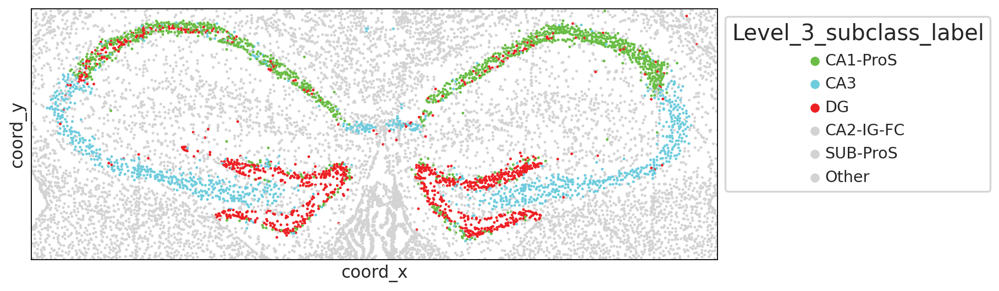

In [22]:
palette_l3 = collections.OrderedDict({
    'CA1-ProS': colors[8],
    'CA3': colors[9],
    'DG': colors[10],
    'CA2-IG-FC': 'lightgray',
    'SUB-ProS': 'lightgray',
    'Other': 'lightgray',
})
hue_order = list(palette_l3.keys())

level = levels[2]
dfplot = res.copy()
dfplot[level] = dfplot[level].apply(lambda x: x if x in hue_order else 'Other')

# dfplot = res2.copy() #[res[levels[0]]=='Glutamatergic']
# dfplot[level] = dfplot[level].apply(lambda x: x if x in hue_order else 'Other')

fig, ax = plt.subplots(figsize=(10,8))
sns.scatterplot(data=dfplot, x='coord_x', y='coord_y', hue=level,
                # hue_order=np.sort(np.unique(res[level])),
                hue_order=hue_order,
                palette=palette_l3,
                s=5,
                edgecolor='none',
                rasterized=True,
               )
# ax.axis('off')
ax.set_xticks([])
ax.set_yticks([])
# ax.set_xlim([-2100, 2000])
# ax.set_ylim([-2250, -750])
ax.set_xlim([x, x+w])
ax.set_ylim([y, y+h])
ax.legend(bbox_to_anchor=(1,1), 
          loc='upper left', 
          # ncol=1+int(len(np.unique(res[level]))/20), 
          title=level,
         )
ax.invert_yaxis()
ax.set_aspect('equal')
powerplots.savefig_autodate(fig, os.path.join(fig_dir, 'spatial_level3_hippo_allcells.pdf'))
plt.show()

### integrated UMAPs

In [23]:
# # used the cluster together with the UMAP
# f = '/bigstore/GeneralStorage/fangming/projects/dredfish/data_dump/celltypes_baseline_test_April18.npy'
# res_clst = np.load(f, allow_pickle=True)
# res_clst = pd.DataFrame(res_clst, columns=levels, index=res.index)
# dfclst = pd.concat([ref_data.obs, res_clst]).dropna(axis=1)[levels]

# f = "/bigstore/GeneralStorage/fangming/projects/dredfish/data_dump/umap_corrected_features_using_labels.csv"
# df_embintg = pd.read_csv(f, index_col=0)
# df_embintg = df_embintg.join(dfclst)

# f = "/bigstore/GeneralStorage/fangming/projects/dredfish/data_dump/integrated_UMAP_clusters_fixed_features_test_April18.csv"
# df_embintg.to_csv(f, index=True, header=True)

In [24]:
f = "/bigstore/GeneralStorage/fangming/projects/dredfish/data_dump/integrated_UMAP_clusters_fixed_features_test_April18.csv"
df_embintg = pd.read_csv(f, index_col=0)
df_embintg

,dataset,embed_1,embed_2,Level_1_class_label,Level_2_neighborhood_label,Level_3_subclass_label
US-1250273_E1_S37,scRNA-seq,-1.975995,-5.147836,Glutamatergic,PT,L5 PT CTX
US-1250273_E2_S01,scRNA-seq,-1.556432,-5.805800,Glutamatergic,PT,L5 PT CTX
US-1250273_E2_S02,scRNA-seq,-2.192369,-5.709384,Glutamatergic,PT,L5 PT CTX
US-1250273_E2_S03,scRNA-seq,1.790755,-1.702550,Glutamatergic,L4/5/6 IT Car3,L5 IT CTX
US-1250273_E2_S04,scRNA-seq,-2.847909,-4.512264,Glutamatergic,PT,L5 PT CTX
...,...,...,...,...,...,...
DPNMF_PolyA_2021Nov19_Pos102_cell_1351.0,dredFISH,2.001457,18.743460,Non-Neuronal,Other,Astro
DPNMF_PolyA_2021Nov19_Pos102_cell_1352.0,dredFISH,-6.029787,20.350470,Non-Neuronal,Other,Oligo
DPNMF_PolyA_2021Nov19_Pos102_cell_1353.0,dredFISH,-5.770394,20.208958,Non-Neuronal,Other,Oligo
DPNMF_PolyA_2021Nov19_Pos102_cell_1356.0,dredFISH,-5.734208,20.375797,Non-Neuronal,Other,Oligo


saved the figure to: /bigstore/GeneralStorage/fangming/projects/dredfish/figures/umap_intg_2022-05-11.pdf


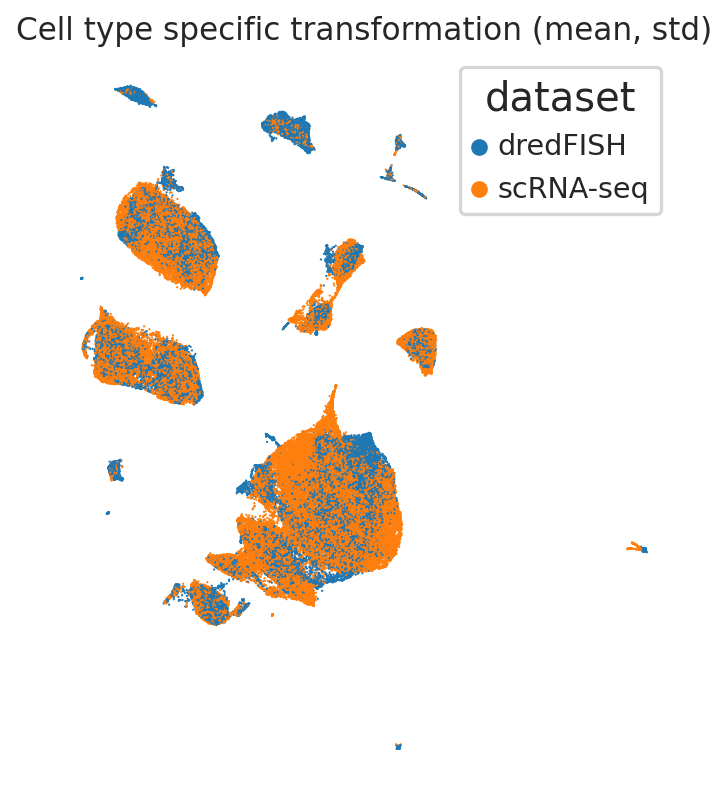

In [25]:
fig, ax = plt.subplots(figsize=(8,6))
sns.scatterplot(data=df_embintg.sample(frac=1), 
                x='embed_1', y='embed_2', hue='dataset',
                s=1, 
                edgecolor="none",
                rasterized=True,
               )
ax.axis('off')
ax.set_aspect('equal')
ax.set_title('Cell type specific transformation (mean, std)')
powerplots.savefig_autodate(fig, os.path.join(fig_dir, 'umap_intg.pdf'))
plt.show()

saved the figure to: /bigstore/GeneralStorage/fangming/projects/dredfish/figures/umap_intg_bycelltype_2022-05-11.pdf


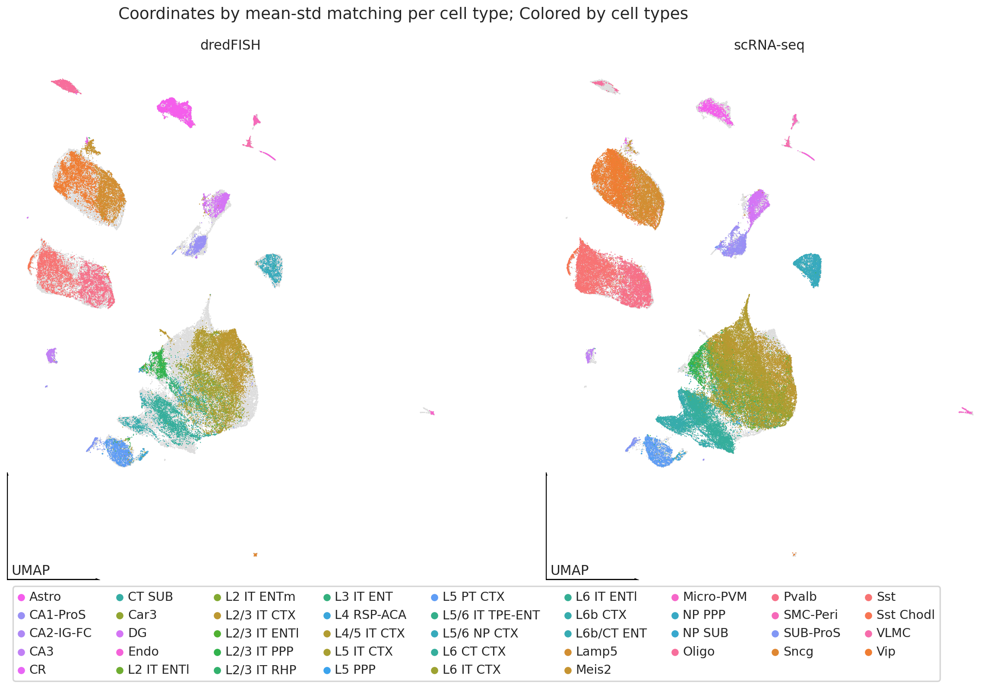

In [26]:
dfplot = df_embintg
palette = meta['l3_palette']

fig, axs = plt.subplots(1, 2, figsize=(10*2,10))

datasets = np.sort(dfplot['dataset'].unique())
hue_order = np.sort(dfplot['Level_3_subclass_label'].unique())

for i, (ax, dataset) in enumerate(zip(axs, datasets)):
    dfsub = dfplot[dfplot['dataset']==dataset]
    if i == 0:
        legend = True
    else:
        legend = False
        
    sns.scatterplot(data=dfplot,
                    x='embed_1', y='embed_2',# hue='Level_3_subclass_label',
                    color='lightgray',
                    s=1,
                    rasterized=True,
                    ax=ax,
                   )
    sns.scatterplot(data=dfsub.sample(frac=1), 
                    x='embed_1', y='embed_2', hue='Level_3_subclass_label',
                    s=1, 
                    edgecolor="none",
                    legend=legend,
                    hue_order=hue_order,
                    palette=palette,
                    rasterized=True,
                    ax=ax,
                   )
    # sns.despine(ax=ax)
    ax.axis('off')
    ax.arrow(0,0, 0, 0.2, fc='k', ec='k', transform=ax.transAxes)
    ax.arrow(0,0, 0.2, 0, fc='k', ec='k', transform=ax.transAxes)
    ax.text(0.01,0.01, "UMAP", transform=ax.transAxes)
    ax.set_aspect('equal')
    ax.set_title(dataset)
    
    if i == 0:
        ax.legend(loc='upper left', bbox_to_anchor=(0,0), ncol=9)
    
fig.subplots_adjust(wspace=0)
fig.suptitle('Coordinates by mean-std matching per cell type; Colored by cell types')
powerplots.savefig_autodate(fig, os.path.join(fig_dir, 'umap_intg_bycelltype.pdf'))
plt.show()

# Cluster level

In [27]:
celltype_n = resobj.Xobs.groupby(list(levels)).size()
celltype_n = celltype_n[celltype_n!=0]
celltype_n

Level_1_class_label  Level_2_neighborhood_label  Level_3_subclass_label
GABAergic            CGE                         Lamp5                      4805
                                                 Sncg                       1555
                                                 Vip                        6329
                     MGE                         Pvalb                      4109
                                                 Sst                        5511
                                                 Sst Chodl                   282
                     Other                       Meis2                       132
Glutamatergic        DG/SUB/CA                   CA1-ProS                   1704
                                                 CA2-IG-FC                    19
                                                 CA3                         322
                                                 DG                         2474
                                     

In [28]:
# nth = celltype_n.sum()*0.005
# celltype_n[celltype_n>nth]


excluded: []
saved the figure to: /bigstore/GeneralStorage/fangming/projects/dredfish/figures/celltype_heatmap_allcells_2022-05-11.pdf


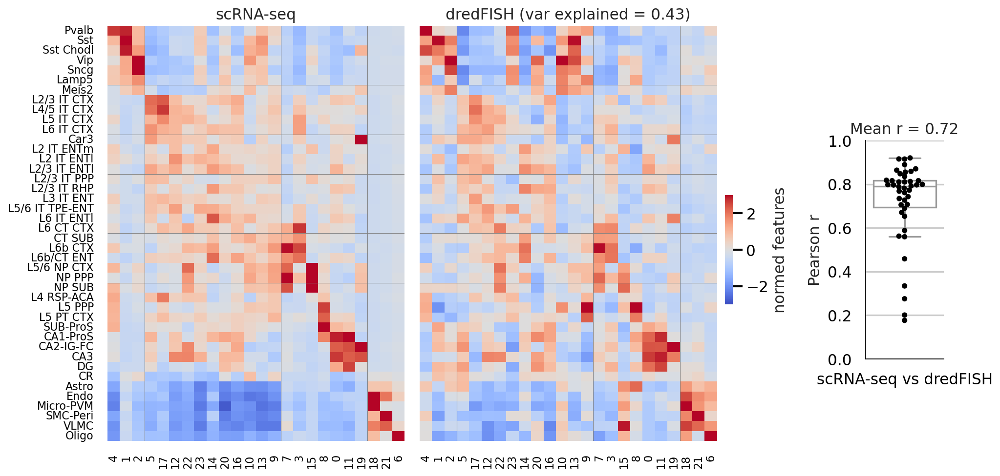

In [29]:
importlib.reload(evalu)

outpath = os.path.join(fig_dir, 'celltype_heatmap_allcells.pdf')
Xclst, Yclst = resobj.get_cluster_level()

evalu.plot_validation_genes_level3(
    Xclst, Yclst, 
    [5, 10, 14, 20, 25], [2, 13, 20],
    # meta['l3_hlines'], meta['l3_vlines'], 
    xtitle=resobj.Xname, ytitle=resobj.Yname,
    show_rows_in_both_only=True,
    figsize=(10,7),
    outpath=outpath,
    )